In [1]:
import warnings
warnings.filterwarnings('ignore',category=RuntimeWarning)
import xarray as xr
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import glob,os,sys
from tqdm import tqdm
import proplot as plot
import json,pickle
import dask.array as da
import gc
from sklearn.decomposition import PCA
sys.path.insert(1, '/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/')
from tools import derive_var,read_and_proc,preproc_noensemble
from tools.mlr import mlr,maria_IO
from tools.preprocess import do_eof,preproc_maria
#import feature_select
%matplotlib inline
#%matplotlib notebook
plot.rc.update({'figure.facecolor':'w','axes.labelweight':'ultralight',
                'tick.labelweight':'ultralight','gridminor.linestyle':'--','title.weight':'normal','linewidth':0.5})
#from dask import delayed
#from dask.distributed import Client
#import dask.array as da
#client = Client(processes=True, threads_per_worker=1,n_workers=2)

/tmp/ipykernel_3183397/1439395459.py:22: ProplotWarning: rc setting 'linewidth' was renamed to 'meta.width' in version 0.8.
  plot.rc.update({'figure.facecolor':'w','axes.labelweight':'ultralight',


#### Produce Input-Output

In [2]:
# Basic settings
folderpath='/work/FAC/FGSE/IDYST/tbeucle.explained_variance_ratio_/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/uvwheat/'#preproc/24h_smoo/'
PCAdict = read_and_proc.depickle(folderpath+'PCA/ctl_PCA_dict1')

In [17]:
for inx,i in enumerate(['u', 'v', 'w', 'theta', 'heatsum', 'hdia', 'rad']):
    print(np.abs(PCAdict[i].explained_variance_ratio_.cumsum()-0.95).argmin())

5
2
12
5
12
12
10


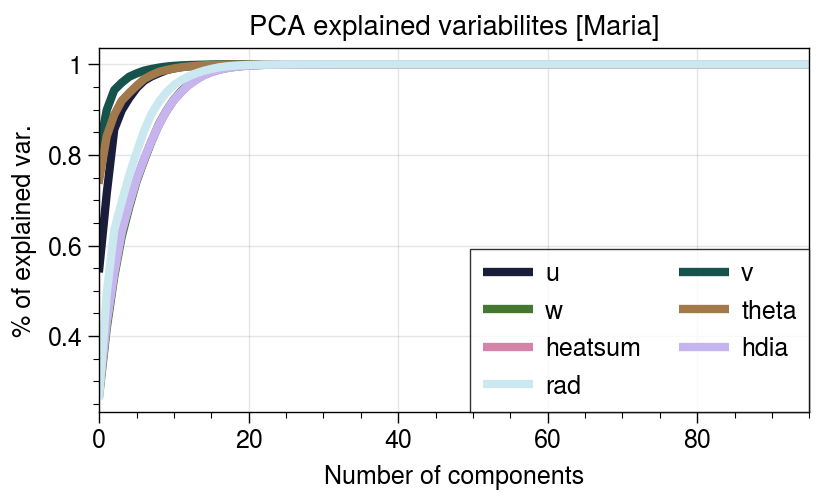

In [13]:
path = '/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/'
with sns.color_palette("cubehelix", n_colors=7):
    fig,ax = plot.subplots(ncols=1,nrows=1,axwidth=3.55,refaspect=1.951,sharey=3,sharex=0) 
    for inx,i in enumerate(['u', 'v', 'w', 'theta', 'heatsum', 'hdia', 'rad']):
        ax.plot(PCAdict[i].explained_variance_ratio_.cumsum(),lw=3,label=i)
    ax.format(title='PCA explained variabilites [Maria]',xlabel='Number of components',ylabel='% of explained var.')
    ax.legend(loc=4,ncol=2)
    plt.savefig(path+'testML/figures/0406/pcaMARIA_fig.png',dpi=300)
    plt.show()

#### Generate normalized time series

In [104]:
def read_mariaradexp(pathprefix=None,expname=None,var=None,suffix=None):
    return [read_and_proc.depickle(pathprefix+lime+suffix)[var][24:120] for lime in expname]

def myPCA_projection_sen(pca_dict=None,varname=None,toproj_flatvar=None,orig_flatvar=None):
    pca_orig = pca_dict[varname].transform(orig_flatvar)
    if pca_dict[varname].mean_ is not None:
        orig_mean = pca_dict[varname].mean_
    projvar_transformed = np.dot(toproj_flatvar-np.nanmean(toproj_flatvar,axis=0),pca_dict[varname].components_.T)
    del orig_mean
    gc.collect()
    return pca_orig, projvar_transformed

class do_radPCcomps:
    def __init__(self,PCAdict=None,basevarname='rad',radvarname=None,nummem=10):
        self.PCAdict=PCAdict
        self.basevarname=basevarname
        self.radvarname=radvarname
        self.nummem = nummem
        self.expname=['ctl','ncrf_36h','ncrf_60h','lwcrf']

    def produce_radcomptimeseries(self,flatvar=None,radflats=None):
        flatvarstemp = [flatvar[expNAME][-1] for expNAME in self.expname]
        basePC = [self.PCAdict['rad'].transform(flatvartempTEMP)[:,0:self.nummem] for flatvartempTEMP in flatvarstemp]
        ts_dict = {}
        for indx,obj in tqdm(enumerate(self.radvarname)):
            radflattemp = radflats[obj]
            temp = [myPCA_projection_sen(pca_dict=self.PCAdict,varname=self.basevarname,toproj_flatvar=radflattemp[i],orig_flatvar=flatvarstemp[0])[1][:,0:self.nummem] for i in range(len(flatvarstemp))]
            ts_dict[obj] = temp
        return ts_dict
    
    def normalize_timeseries_decomp(self,sentimeseries=None,reftimeseries=None,refvarname='rad'):
        ts_dict = {}
        meanstd_dict = {}
        for indx,obj in tqdm(enumerate(self.radvarname)):
            #temp = [ts[obj][expINDEX] for expINDEX in range(len(self.expname))]
            tempf = -np.mean(sentimeseries[obj][0],axis=0)/np.std(reftimeseries[refvarname][0],axis=0)
            ts_dict[obj] = [(sentimeseries[obj][expINDEX]-np.mean(sentimeseries[obj][0],axis=0))/np.std(reftimeseries[refvarname][0],axis=0) for expINDEX in range(len(self.expname))]
            meanstd_dict[obj] = tempf#np.broadcast_to(tempf, (sentimeseries[obj].shape[0], sentimeseries[obj].shape[1]))
        return ts_dict,meanstd_dict
    
    def produce_Qsentimeseries(self,senvar_name=None,refvar_name='rad',numQ=None,flatvar=None,senflatvar=None):
        ts_dict = {}
        temp = [myPCA_projection_sen(pca_dict=self.PCAdict,varname=refvar_name,toproj_flatvar=senflatvar[obj].data,orig_flatvar=flatvar[refvar_name].data)[1][:,0:numQ] for indx,obj in enumerate(senvar_name)]
        return dict(zip(senvar_name,temp))

In [3]:
# Basic settings
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/uvwheat/'#preproc/24h_smoo/'
expname = ['ctl','ncrf_36h','ncrf_60h','lwcrf']
varname = ['u','v','w','qv','theta','hdia','rad']
#################################################################################
# Orig model
#nummem = [36,16,44,8,6,23] (40% du/dv/dw; 90% qv/theta/heatsum)
#nummem = [12,3,26,5,10,23] #(25% du/dv/dw; 30% dth) %[12,3,26,5,3,19]
#nummem = [22,8,35,5,19,29] # 35% du/dv/dw/dtheta, 93%
nummem = [54,26,50,5,75,12,10]
#################################################################################
# 24-hr smoothing model
PCAdict = read_and_proc.depickle(folderpath+'PCA/ctl_PCA_dict1')
# Read files
flatvar = [read_and_proc.depickle(folderpath+'preproc/'+str(expname[i])+'_'+'smooth_preproc_dict1b_g') for i in range(len(expname))]
vardicts = maria_IO.input_output(PCAdict,folderpath,varname,nummem).readvar_separate(listdict=flatvar,varname=['u','v','w','qv','theta','hdia','rad'])
del flatvar#,thetavar
gc.collect()
#################################################################################
# theta
#PCAtheta = read_and_proc.depickle(folderpath+'PCA/theta_PCA_dict1')
#folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/flatvar/'
#thetavar = read_and_proc.depickle(folderpath+'theta_'+'preproc_dict1')
# Heat equation
#folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/'
#radvar,noradvar = read_and_proc.depickle(folderpath+'/complex/Q95_complex/'+'smooIR_'+'preproc_dict1'),\
#read_and_proc.depickle(folderpath+'/complex/Q95_complex/'+'smooNOIR_'+'preproc_dict1')
#vardicts = maria_IO.input_output(PCAdict,folderpath,varname,nummem).readvar_sen_alt(listdict=flatvar,thetaflat=thetavar,heatcompflat=[radvar,noradvar])

4

In [3]:
qvheat = [np.abs(PCAdict[i].explained_variance_ratio_.cumsum()-0.99).argmin() for i in ['qv','heatsum']]
theta = np.abs(PCAtheta['theta'].explained_variance_ratio_.cumsum()-0.99).argmin()
print(f'qvheat commponents: {qvheat}; theta component: {theta}')

qvheat commponents: [27, 63]; theta component: 20


##### Check components

In [ ]:
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/'
print(maria_IO.datacheck(folderpath,'uvwheat/PCA/ctl_PCA_dict1').dthdQVAR('dthdQ_preproc_dict1','theta'))

##### Save normalized and unnormalized TS

In [117]:
class input_output:
    def __init__(self,PCAdict=None,folderpath=None,ts_varname=None,nummem=None):
        self.PCAdict = PCAdict
        self.expname=['ctl','ncrf_36h','ncrf_60h','lwcrf']
        self.nummem = nummem # u: 36 (40% variability in du), v:16/32 (40% dv var;50%), w:44 (40% dw var)
        self.ts_varname = ts_varname
    ###################################################################################################################################################
    # Read var
    ###################################################################################################################################################
    def readvar(self,listdict=None,varname=['u','v','w','qv','heatsum'],withtheta='Yes',thetaflat=None,smooth24=False):
        # Smooth24 or nosmooth
        vardict = {}
        if smooth24:
            withtheta='No'
            varname=['u','v','w','qv','theta','heatsum']
        else:
            withtheta='Yes'
            varname=['u','v','w','qv','heatsum']
        # Read array
        for indx,obj in enumerate(self.expname):
            if withtheta=='Yes':
                templist = [listdict[indx][strvar][24:120] for strvar in varname]
                theta = thetaflat[list(thetaflat.keys())[indx]][24:120]
                heatsum = templist[4]
                templist.pop(4)
                templist.insert(4,theta)
                templist.insert(5,heatsum)
                assert len(templist)==6
                vardict[obj] = templist
            else:
                vardict[obj] = [listdict[indx][strvar][24:120] for strvar in varname]
        return vardict
    
    def readvar_separate(self,listdict=None,varname=['u','v','w','qv','heatsum']):
        # Smooth24 or nosmooth
        vardict = {}
        # Read array
        for indx,obj in enumerate(self.expname):
            vardict[obj] = [listdict[indx][strvar][24:120] for strvar in varname]
        return vardict

    def readvar_sen(self,listdict=None,varname=['u','v','w','qv','heatsum'],withtheta='Yes',thetaflat=None,heatcompflat=None):
        vardict = {}
        for indx,obj in enumerate(self.expname):
            if withtheta=='Yes':
                templist = [listdict[indx][strvar][24:120] for strvar in varname]
                theta = thetaflat[list(thetaflat.keys())[indx]][24:120]
                heatcomp = heatcompflat[list(heatcompflat.keys())[indx]][24:120]
                heatsum = templist[4]
                templist.pop(4)
                templist.insert(4,theta)
                templist.insert(5,heatsum)
                templist.insert(6,heatcomp)
                assert len(templist)==7
                vardict[obj] = templist
        return vardict
    
    def readvar_sen_alt(self,listdict=None,varname=['u','v','w','qv','heatsum'],withtheta='Yes',thetaflat=None,heatcompflat=None):
        vardict = {}
        for indx,obj in enumerate(self.expname):
            if withtheta=='Yes':
                templist = [listdict[indx][strvar][24:120] for strvar in varname]
                theta = thetaflat[list(thetaflat.keys())[indx]][24:120]
                heatcomp1,heatcomp2 = heatcompflat[0][list(heatcompflat[0].keys())[indx]][24:120],heatcompflat[1][list(heatcompflat[1].keys())[indx]][24:120]
                heatsum = templist[4]
                templist.pop(4)
                templist.insert(4,theta)
                templist.insert(5,heatcomp1)
                templist.insert(6,heatcomp2)
                assert len(templist)==7
                vardict[obj] = templist
        return vardict
    ###################################################################################################################################################
    # Produce time series
    ###################################################################################################################################################    
    def produce_timeseries(self,flatvar=None):
        ts_dict = {}
        for indx,obj in enumerate(self.ts_varname):
            flatvarstemp = [flatvar[expNAME][indx] for expNAME in self.expname]
            temp = [self.PCAdict[obj].transform(flatvartempTEMP)[:,0:self.nummem[indx]] for flatvartempTEMP in flatvarstemp]
            del flatvarstemp
            gc.collect()
            ts_dict[obj] = temp
        return ts_dict
    
    def produce_timeseries_alt(self,flatvar=None):
        ts_dict = {}
        for indx,obj in enumerate(self.ts_varname):
            if ((obj=='rad') or (obj=='hdia')):
                heatcomptemp = [flatvar[expNAME][indx] for expNAME in self.expname]
                temp = [myPCA_projection_sen(pca_dict=self.PCAdict,varname='heatsum',toproj_flatvar=heatcomptemp[i],\
                                             orig_flatvar=heatcomptemp[0])[1][:,0:self.nummem[indx]] for i in range(len(heatcomptemp))]
                del heatcomptemp
                gc.collect()
                ts_dict[obj] = temp                
            else:
                flatvarstemp = [flatvar[expNAME][indx] for expNAME in self.expname]
                temp = [self.PCAdict[obj].transform(flatvartempTEMP)[:,0:self.nummem[indx]] for flatvartempTEMP in flatvarstemp]
                del flatvarstemp
                gc.collect()
                ts_dict[obj] = temp
        return ts_dict
    
    def produce_sentimeseries(self,flatvar=None):
        ts_dict = {}
        for indx,obj in enumerate(self.ts_varname):
            if obj != 'heatcomp':
                flatvarstemp = [flatvar[expNAME][indx] for expNAME in self.expname]
                temp = [self.PCAdict[obj].transform(flatvartempTEMP)[:,0:self.nummem[indx]] for flatvartempTEMP in flatvarstemp]
                del flatvarstemp
                gc.collect()
                ts_dict[obj] = temp
            else:
                print(self.nummem[indx])
                heatcomptemp = [flatvar[expNAME][indx] for expNAME in self.expname]
                temp = [myPCA_projection_sen(pca_dict=self.PCAdict,varname='heatsum',toproj_flatvar=heatcomptemp[i],\
                                             orig_flatvar=heatcomptemp[0])[1][:,0:self.nummem[indx]] for i in range(len(heatcomptemp))]
                del heatcomptemp
                gc.collect()
                ts_dict[obj] = temp
        return ts_dict

In [121]:
vardicts['ctl'][0].shape

(96, 2344680)

In [125]:
def read_maria(vardicts=None):
    temp1,temp2,temp3,temp4 = vardicts['ctl'],vardicts['ncrf_36h'],vardicts['ncrf_60h'],vardicts['lwcrf']
    mariadata = {}
    for ind,obj in enumerate(['u','v','w','qv','theta','hdia','rad']):
        temp1a,temp2a,temp3a,temp4a = temp1[ind],temp2[ind][36-24-2:],temp3[ind][60-24-2:],temp4[ind][36-24-2:]
        mariadata[obj] = np.concatenate((temp1a,temp2a,temp3a,temp4a),axis=0)
    return mariadata

In [126]:
maria_data = read_maria(vardicts)

In [147]:
from sklearn.decomposition import IncrementalPCA
def fit_cheap_pca(n_batches=None,n_comps=None,var=None):
    #n_batches = 20
    inc_pca = IncrementalPCA(n_components=n_comps)
    for X_batch in tqdm(np.array_split(var.data,n_batches)):
        inc_pca.partial_fit(X_batch)
    return inc_pca

In [150]:
pcarad = fit_cheap_pca(n_batches=5,n_comps=60,var=maria_data['rad'])

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [08:16<00:00, 99.35s/it]


In [152]:
radtest = pcarad.transform(maria_data['rad'])

In [110]:
nummem = [54,26,50,5,75,12,10] #[22,8,35,5,19,63]
#varname = ['u','v','w','qv','theta','heatsum']
varname = ['u','v','w','qv','theta','hdia','rad']
ts_dict = maria_IO.input_output(PCAdict,folderpath,varname,nummem).produce_timeseries(vardicts)
normalts_dict = maria_IO.input_output(PCAdict,folderpath,varname,nummem).normalize(ts=ts_dict)#maria_IO.input_output(PCAdict,folderpath,varname,nummem).normalize(ts=ts_dict)

##### Last ditch effort

In [37]:
def make_X(normlTS=None,varwant=None):
    trainlist = []
    for obj in varwant:
        test1 = normlTS[obj]
        trainlist.append(test1)
    return np.concatenate([trainlist[i] for i in range(len(trainlist))],axis=1)

In [30]:
def new_normal(tsdict=None,var=None):
    temp = [tsdict[var][i] for i in range(len(tsdict[var]))]
    temp1,temp2,temp3,temp4 = temp[0],temp[1][36-24-2:,],temp[2][60-24-2:,],temp[3][36-24-2:,]
    # Put it all together
    TEMP = np.concatenate((temp1,temp2,temp3,temp4),axis=0)
    return (TEMP-np.nanmean(TEMP,axis=0))/np.nanstd(TEMP,axis=0),TEMP

normalts_dict,nonormalts_dict = {},{}
for indx,obj in enumerate(varname):
    TEST,noTEST = new_normal(ts_dict,obj)
    normalts_dict[obj] = TEST
    nonormalts_dict[obj] = noTEST

In [38]:
EXP = [['hdia','rad'],['theta','hdia','rad'],['u','v','w','theta','hdia','rad'],['u','v','theta','hdia','rad'],['u','v'],['u','v','w'],['u','v','hdia','rad'],['u','v','w','hdia','rad'],['u','v','w','theta','qv','hdia','rad']]
storename = ['dt','dtth','dtthuvw','dtthuv','uv','uvw','dtuv','dtuvw','dtthuvwqv']

mlr_input = {}
for ind,obj in enumerate(storename):
    test = make_X(normalts_dict,EXP[ind])
    mlr_input[obj] = test

In [40]:
mlr_input['dtthuvw'].shape,

(330, 227)

In [67]:
def forward_diff(arrayin=None,delta=None,axis=None,LT=1):
    result = []
    if axis==0:
        for i in range(0,arrayin.shape[axis]-LT):
            temp = (arrayin[i+LT,:]-arrayin[i,:])/(LT*delta)
            result.append(temp)
        return np.asarray(result)
    
def get_time_diff_terms(inputvar=None,LT=None):
    def _get_time_diff(array=None,timedelta=60*60,LT=None):
        store = []
        a = forward_diff(array,timedelta,0,LT)
        if a.shape[0]>0:
            azero = np.zeros((LT,array.shape[-1]))
            store.append(np.concatenate((a,azero),axis=0))
        else:
            store.append(np.zeros((array.shape[0],array.shape[-1])))
        return store
    storedict = {}
    for wantvar in ['u','v','w','theta']:
        storedict[wantvar] = np.squeeze(_get_time_diff(array=inputvar[wantvar],LT=LT))
    return storedict
    
def make_Y(inputdict=None,LDT=None,validindex=[1,6],testindex=[2,12]):
    def _make_Y(inputt=None):
        varTRAIN = []
        for varobj in ['u','v','w','theta']:
            varTRAIN.append(inputt[varobj])
        return np.concatenate([varTRAIN[i] for i in range(len(varTRAIN))],axis=1)
    test = [get_time_diff_terms(inputdict,int(LDTobj)) for LDTobj in LDT]
    return [_make_Y(timediffobj) for timediffobj in test]

In [66]:
LDTME = np.linspace(0,44,45)+1
mlr_output = make_Y(nonormalts_dict,LDTME)

[(330, 54), (330, 26), (330, 50), (330, 75)]


In [ ]:
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/'

expname = 'flatPCA_Q95_nonorm'
read_and_proc.save_to_pickle(folderpath+'pca/output/complex/heatcomp_separate/'+str(expname)+'_'+'preproc_dict1',ts_dict,'PICKLE')
expname = 'flatPCA_Q95'
read_and_proc.save_to_pickle(folderpath+'pca/output/complex/heatcomp_separate/'+str(expname)+'_'+'preproc_dict1',normalts_dict,'PICKLE')

##### Save rad equations

In [137]:
# Rad
raddict = {}
for var in ['LW','SW','LWC','SWC','IRLW','IRSW']:
    temp = read_mariaradexp('../output/maria/processed/',['ctl','ncrf_36h','ncrf_60h','lwcrf'],var=var,suffix='_preproc_dict1_g_rads')
    raddict[var] = np.concatenate((temp[0],temp[1][36-24-2:],temp[2][60-24-2:],temp[3][36-24-2:]),axis=0)
#radPCdict = do_radPCcomps(PCAdict=PCAdict,basevarname='rad',radvarname=['LW','SW','LWC','SWC','IRLW','IRSW'],nummem=10).produce_radcomptimeseries(flatvar=vardicts,radflats=raddict)
#a,b = do_radPCcomps(PCAdict=PCAdict,basevarname='rad',radvarname=['LW','SW','LWC','SWC','IRLW','IRSW'],nummem=10).normalize_timeseries_decomp(radPCdict,ts_dict,'rad')

#radcompINPUT = {}
#for varobj in ['LW','SW','LWC','SWC','IRLW','IRSW']:
#    radcompINPUT[varobj] = maria_IO.input_output(PCAdict,folderpath,varname,nummem).create_radinput(a,['ctl','ncrf_36h','ncrf_60h','lwcrf'],24,2,varobj)

In [ ]:
myPCA_projection_sen(pca_dict=PCAdict,varname=refvar_name,toproj_flatvar=senflatvar[obj].data,orig_flatvar=radtest[:,0:20])[1][:,0]

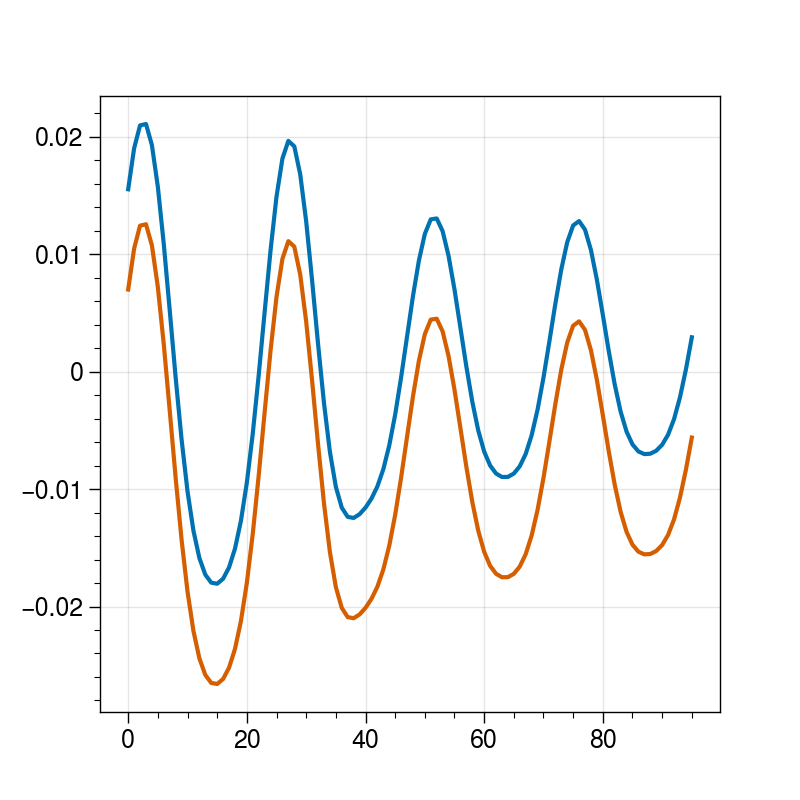

In [116]:
plt.plot((radPCdict['IRLW'][2][:,0]+radPCdict['IRSW'][2][:,0]+radPCdict['LWC'][2][:,0]+radPCdict['SWC'][2][:,0]))
plt.plot(ts_dict['rad'][2][:,0])
plt.show()

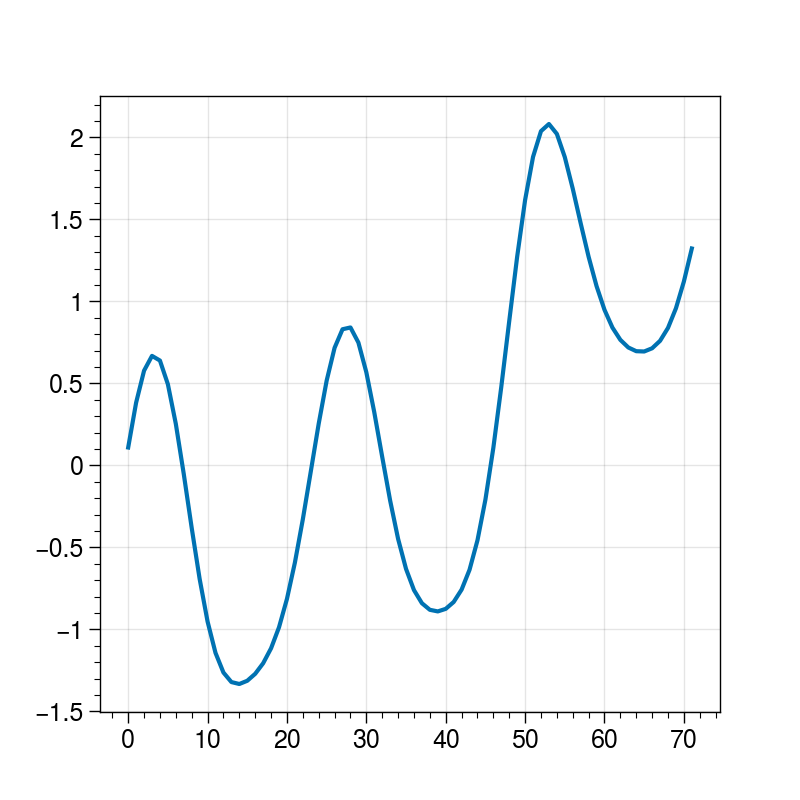

In [23]:
plt.plot(normalts_dict['rad'][0][24:24+96,0])
#plt.plot(radcompINPUT['LW'][96+2:180+2,0]+radcompINPUT['SW'][96+2:180+2,0])#+radcompINPUT['LW'][0:96,0]+radcompINPUT['LW'][0:96,0])
plt.show()

In [48]:
folderpath='../output/maria/processed/'
expname = 'radcomp_dict'
read_and_proc.save_to_pickle(folderpath+'radcomp/'+str(expname),radcompINPUT,'PICKLE')

In [6]:
import importlib
importlib.reload(maria_IO)

varname = ['u','v','w','qv','theta','heatsum','rad','hdia']#['u','v','w','qv','theta','heatsum','heatcomp']
nummem = [54,26,50,5,75,36,36]#[22,8,35,5,19,29,29]
PCAdict['theta'] = PCAtheta['theta']
del PCAtheta
gc.collect()
ts_dict = maria_IO.input_output(PCAdict,folderpath,varname,nummem).produce_sentimeseries(vardicts)

varname = ['u','v','w','qv','theta','heatsum']
normalts_dict = maria_IO.input_output(PCAdict,folderpath,varname,nummem).normalize_sen(ts=ts_dict)

36


In [7]:
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/'

expname = 'flatPCA_noir_nonorm'
read_and_proc.save_to_pickle(folderpath+'pca/output//complex/Q95_complex/heateq/'+str(expname)+'_'+'preproc_dict1',ts_dict,'PICKLE')
expname = 'flatPCA_noir'
read_and_proc.save_to_pickle(folderpath+'pca/output//complex/Q95_complex/heateq/'+str(expname)+'_'+'preproc_dict1',normalts_dict,'PICKLE')

##### Generate Input Dictionary

In [3]:
expname = 'flatPCA_rad'
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/'
norml_ts = read_and_proc.depickle(folderpath+'pca/output/complex/Q95_complex/heateq/'+str(expname)+'_'+'preproc_dict1')
nonorml_ts = read_and_proc.depickle(folderpath+'pca/output/complex/Q95_complex/heateq/'+str(expname)+'_nonorm'+'_'+'preproc_dict1')

expname = 'flatPCA_norad'
norml_ts_norad = read_and_proc.depickle(folderpath+'pca/output/complex/Q95_complex/heateq/'+str(expname)+'_'+'preproc_dict1')
nonorml_ts_norad = read_and_proc.depickle(folderpath+'pca/output/complex/Q95_complex/heateq/'+str(expname)+'_nonorm'+'_'+'preproc_dict1')

In [4]:
def smooth_array_along_axis(array=None,axis=None,window=3):
    if axis==0:
        aN = array.copy()
    else:
        aN = np.swapaxes(array,axis,0)
    aN = aN.reshape((aN.shape[0], -1))
    return np.asarray([np.convolve(aN[:,i],np.ones(window)/window,'same')[0:aN.shape[0]] for i in range(len(aN[0,:]))]).transpose()

In [27]:
np.abs(np.nanmean(norml_ts['heatsum'][0],axis=0))>np.abs(np.nanmean(norml_ts_norad['heatsum'][0],axis=0))

array([False, False,  True, False, False,  True, False,  True, False,
       False, False, False, False, False,  True, False, False, False,
       False,  True, False, False, False,  True,  True, False,  True,
       False, False, False, False, False, False, False, False, False])

##### Input/Output

In [5]:
expname = 'flatPCA_Q95'
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/'
norml_ts = read_and_proc.depickle(folderpath+'pca/output/complex/heatcomp_separate/'+str(expname)+'_'+'preproc_dict1')
nonorml_ts = read_and_proc.depickle(folderpath+'pca/output/complex/heatcomp_separate/'+str(expname)+'_nonorm'+'_'+'preproc_dict1')

In [6]:
# Basic settings
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/uvwheat/'
expname = ['ctl','ncrf_36h','ncrf_60h','lwcrf']
varname = ['u','v','w','qv','theta','hdia','rad']
nummem = [54,26,50,5,75,12,10]#[54,26,50,5,75,36]#[22,8,35,5,19,63]#[36,16,44,8,6,23] 29->36(Q95)->46(Q97)->53(Q98)->63(Q59)
PCAdict = read_and_proc.depickle(folderpath+'PCA/ctl_PCA_dict1')
#PCAtheta = read_and_proc.depickle(folderpath+'PCA/theta_PCA_dict1')
#PCAdict['theta'] = PCAtheta['theta']
#del PCAtheta
#gc.collect()

input_dict = maria_IO.input_output(PCAdict,folderpath,varname,nummem).create_input(normalts_dict,expname,24,2,True) #True = rad/hdia separation; False: one heatsum term
LDTME = np.linspace(0,44,45)+1
mlr_output = []
for index,TIMEstamp in enumerate(LDTME):
    mlr_output.append(maria_IO.input_output(PCAdict,folderpath,varname,nummem).produce_output_LT(ts_dict,expname,int(TIMEstamp),nummem,24,2))

dt
dtth
dtthuvw
dtthuv
uv
uvw
dtuv
dtuvw
dtthuvwqv


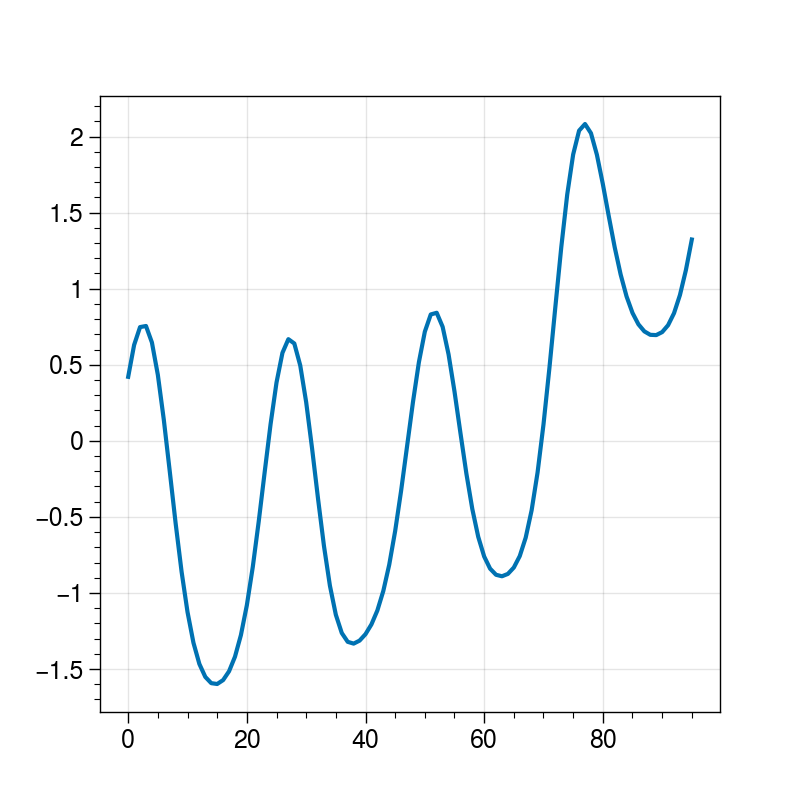

In [8]:
plt.plot(input_dict['dtuvw'][0:96,-10])
plt.show()

In [80]:
#folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/'
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/testML/output/maria/processed/inputoutput'
expname = 'inputQ95_dict_new'
read_and_proc.save_to_pickle(folderpath+'/'+str(expname)+'_'+'smoo6_withtheta',mlr_input,'PICKLE')
expname = 'outputQ95_dict_new'
read_and_proc.save_to_pickle(folderpath+'/'+str(expname)+'_'+'smoo6_withtheta',mlr_output,'PICKLE')

Animation size has reached 21546308 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


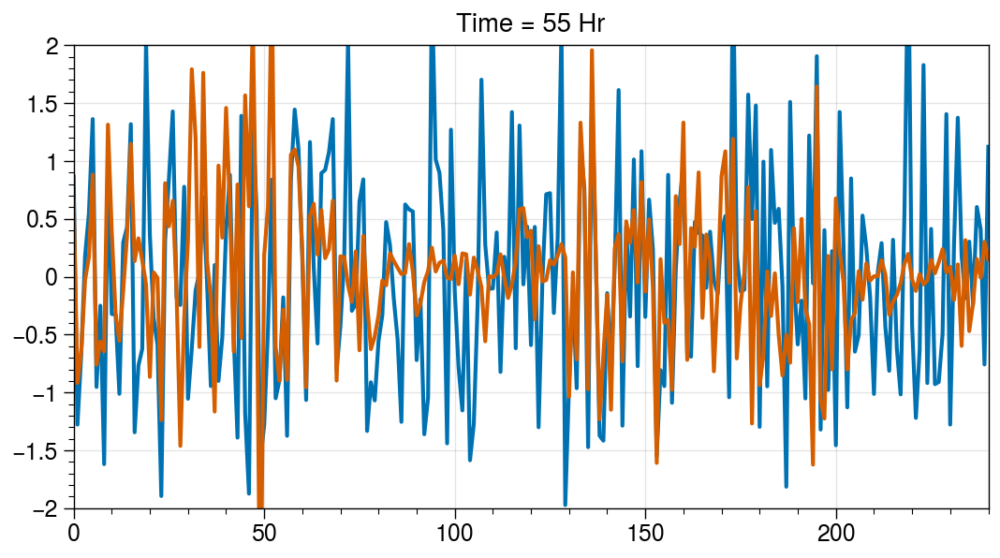

In [ ]:
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

fig,axs = plot.subplots(ncols=1,nrows=1,axwidth=4.595,refaspect=2.031)
l, = axs[0].plot([],[])
l2, = axs[0].plot([],[])
axs.format(xlim=[0,240],ylim=[-2,2])

def animate(i):
    time = 36+i
    axs[0].set_title(u"Time = {} Hr".format(time))
    #print(input_dict['dtthuvw'][10+i,:])
    l.set_data(np.linspace(0,240,241),input_dict['dtthuvw'][10+i,:])
    l2.set_data(np.linspace(0,240,241),input_dict['dtthuvw'][96+i,:])

ani = animation.FuncAnimation(fig, animate, frames=20, blit=False, repeat=False)
ani.save('./figures/PC_testanim.mp4', writer='ffmpeg', fps=10, dpi=100) #metadata={'title':'test'})
HTML(ani.to_jshtml())